In [6]:
%matplotlib inline

import numpy as np
import pandas as pd
import dicom
import os
import scipy.ndimage
import matplotlib.pyplot as plt

from skimage import measure, morphology
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Some constants 
INPUT_FOLDER = '../../../data/dsb/sample_images/'
patients = os.listdir(INPUT_FOLDER) # patients is a list of all 20 patient ids in sample_images
patients.sort()
print(patients)

['00cba091fa4ad62cc3200a657aeb957e', '0a099f2549429d29b32f349e95fb2244', '0a0c32c9e08cc2ea76a71649de56be6d', '0a38e7597ca26f9374f8ea2770ba870d', '0acbebb8d463b4b9ca88cf38431aac69', '0b20184e0cd497028bdd155d9fb42dc9', '0bd0e3056cbf23a1cb7f0f0b18446068', '0c0de3749d4fe175b7a5098b060982a1', '0c37613214faddf8701ca41e6d43f56e', '0c59313f52304e25d5a7dcf9877633b1', '0c60f4b87afcb3e2dfa65abbbf3ef2f9', '0c98fcb55e3f36d0c2b6507f62f4c5f1', '0c9d8314f9c69840e25febabb1229fa4', '0ca943d821204ceb089510f836a367fd', '0d06d764d3c07572074d468b4cff954f', '0d19f1c627df49eb223771c28548350e', '0d2fcf787026fece4e57be167d079383', '0d941a3ad6c889ac451caf89c46cb92a', '0ddeb08e9c97227853422bd71a2a695e', '0de72529c30fe642bc60dcb75c87f6bd']


In [2]:
# Load the scans in given folder path
def load_scan(path):
    slices = [dicom.read_file(path + '/' + s) for s in os.listdir(path)] # slices becomes a list of all dicom images for each patient
    slices.sort(key = lambda x: int(x.InstanceNumber)) # sort all of the slices by their InstanceNumber (which determines their order)
    try: # try to find z location of the slice from ImagePositionPatient attribute
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2]) 
    except: # otherwise, subtract one slice location from the other to get the thickness
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices: # for slice, make new attribute that is the slice's thickness 
        s.SliceThickness = slice_thickness
        
    return slices

In [3]:
def get_pixels_hu(scans):
    image = np.stack([s.pixel_array for s in scans]) # image = 3D numpy array where each layer is a scan
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 0
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    intercept = scans[0].RescaleIntercept
    slope = scans[0].RescaleSlope
    
    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)
        
    image += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

In [4]:
patient_scans = load_scan(INPUT_FOLDER + patients[4])
patient_pixels = get_pixels_hu(patient_scans)

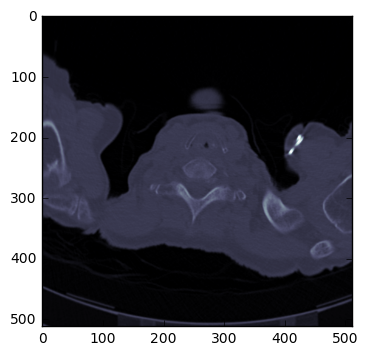

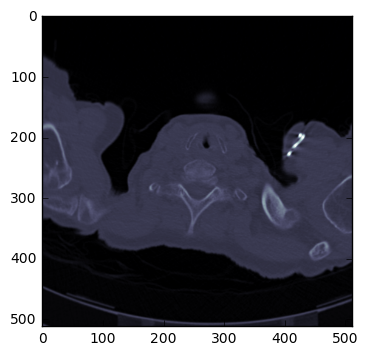

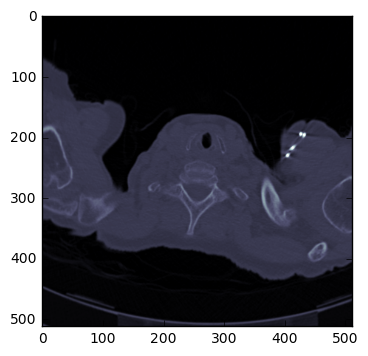

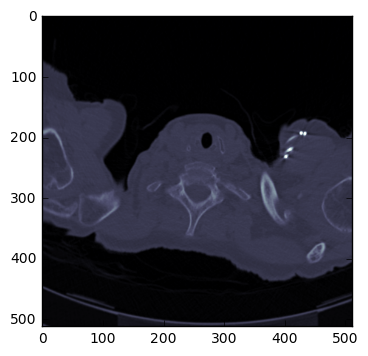

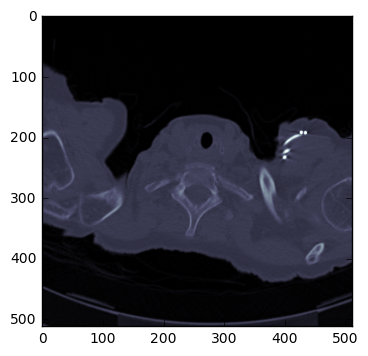

...

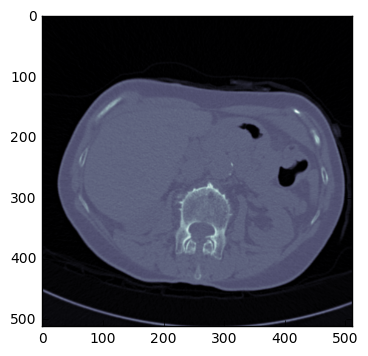

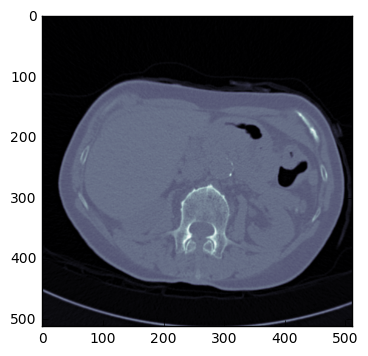

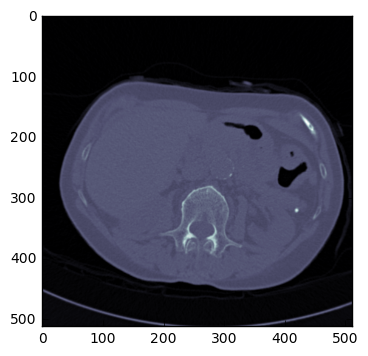

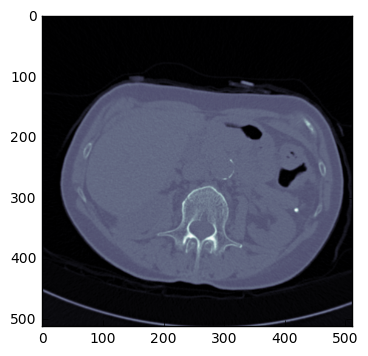

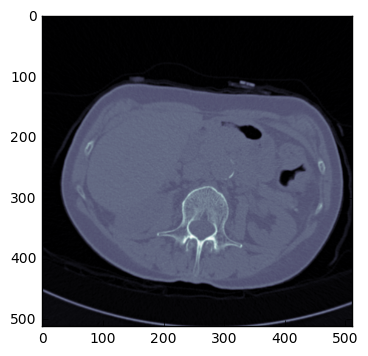

In [5]:
for i in range(203):
    plt.imshow(patient_pixels[i], cmap=plt.cm.bone)
    plt.show()

In [7]:
print(patient_pixels.shape)

(203, 512, 512)


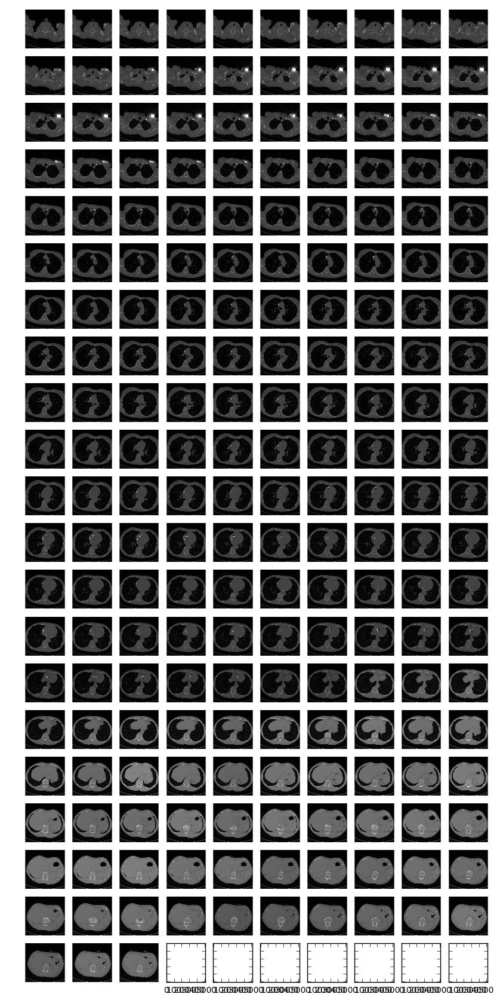

In [24]:
f, plots = plt.subplots(21, 10, sharex='all', sharey='all', figsize=(10, 21))
for i in range(203):
    plots[i // 10, i % 10].axis('off')
    plots[i // 10, i % 10].imshow(patient_pixels[i], cmap=plt.cm.gray)

In [17]:
print(patients[0])

00cba091fa4ad62cc3200a657aeb957e


In [7]:
df_train = pd.read_csv('../../../data/dsb/stage1_labels.csv')
print(df_train)

                                    id  cancer
0     0015ceb851d7251b8f399e39779d1e7d       1
1     0030a160d58723ff36d73f41b170ec21       0
2     003f41c78e6acfa92430a057ac0b306e       0
3     006b96310a37b36cccb2ab48d10b49a3       1
4     008464bb8521d09a42985dd8add3d0d2       1
5     0092c13f9e00a3717fdc940641f00015       0
6     00986bebc45e12038ef0ce3e9962b51a       0
7     00cba091fa4ad62cc3200a657aeb957e       0
8     00edff4f51a893d80dae2d42a7f45ad1       1
9     0121c2845f2b7df060945b072b2515d7       0
10    013395589c01aa01f8df81d80fb0e2b8       0
11    01de8323fa065a8963533c4a86f2f6c1       0
12    01e349d34c06410e1da273add27be25c       0
13    01f1140c8e951e2a921b61c9a7e782c2       0
14    024efb7a1e67dc820eb61cbdaa090166       0
15    0257df465d9e4150adef13303433ff1e       1
16    0268f3a7a17412178cfb039e71799a80       0
17    026be5d5e652b6a7488669d884ebe297       0
18    02801e3bbcc6966cb115a962012c35df       1
19    028996723faa7840bb57f57e28275e4c       1
20    0334c82

In [9]:
df_train = df_train.set_index(['id'])
df_train_row = df_train.loc[patients[4]]
print(df_train_row['cancer'])

1
